## Prep/loading data

In [76]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import LogLocator, FuncFormatter
from sklearn.preprocessing import StandardScaler
import os, sys
parent_dir = os.path.abspath('../../')
if parent_dir not in sys.path:
    sys.path.append(parent_dir)
from functions.back_transformations import inverse_scale_variable, predict_with_back_transform

Get regression results objects

In [77]:
%store -r bivariate_regressions_balanced
%store -r bivariate_regressions_unbalanced
%store -r bivariate_regressions_balanced_accounts
%store -r bivariate_regressions_unbalanced_accounts
%store -r bivariate_regressions_balanced_exiobase
%store -r bivariate_regressions_unbalanced_exiobase
%store -r bivariate_regressions_balanced_accounts_exiobase
%store -r bivariate_regressions_unbalanced_accounts_exiobase

%store -r single_regressions_balanced
%store -r single_regressions_unbalanced
%store -r single_regressions_balanced_accounts
%store -r single_regressions_unbalanced_accounts
%store -r single_regressions_balanced_exiobase
%store -r single_regressions_unbalanced_exiobase
%store -r single_regressions_balanced_accounts_exiobase
%store -r single_regressions_unbalanced_accounts_exiobase

%store -r multiple_regressions_balanced
%store -r multiple_regressions_unbalanced
%store -r multiple_regressions_balanced_accounts
%store -r multiple_regressions_unbalanced_accounts
%store -r multiple_regressions_balanced_exiobase
%store -r multiple_regressions_unbalanced_exiobase
%store -r multiple_regressions_balanced_accounts_exiobase
%store -r multiple_regressions_unbalanced_accounts_exiobase

Here's an example of what info each object has, `data` contains the data used to fit the regression in a data frame, model is the `model` object

In [78]:
bivariate_regressions_balanced[1].keys()

dict_keys(['model', 'type', 'f-statistic', 'hausman_test', 'goodness_of_fit', 'name', 'data', 'independent_variable', 'dependent_variables', 'hausman_test_pass', 'hausman_test_p_value', 'f_test_pass', 'f_test_p_value'])

In [79]:
foundational_df_no_transformations = pd.read_csv('./output/foundational_no_transformations.csv')
foundational_df_transformed = pd.read_csv('./output/foundational_transformed.csv')
foundational_df_no_transformations_accounts = pd.read_csv('./output/foundational_no_transformations_accounts.csv')
foundational_df_transformed_accounts = pd.read_csv('./output/foundational_transformed_accounts.csv')

In [80]:
# foundational_df_no_transformations_exiobase = pd.read_csv('./output/foundational_df_no_transformations_exiobase_no_outliers.csv')
foundational_df_transformed_exiobase = pd.read_csv('./output/foundational_df_transformed_no_outliers_exiobase.csv')
# foundational_df_no_transformations_accounts_exiobase = pd.read_csv('./output/foundational_df_no_transformations_accounts_exiobase_no_outliers.csv')
foundational_df_transformed_accounts_exiobase = pd.read_csv('./output/foundational_df_transformed_no_outliers_accounts_exiobase.csv')
foundational_df_no_transformations_no_outliers_exiobase = pd.read_csv('./output/foundational_df_no_transformations_no_outliers_exiobase.csv')
foundational_df_no_transformations_no_outliers_accounts_exiobase = pd.read_csv('./output/foundational_df_no_transformations_no_outliers_accounts_exiobase.csv')

Values from StandardScaler used to transform the data. We'll need them for the back transformation.

In [81]:
# as a data frame
scaler_df = pd.read_csv('./output/scaler_values.csv')
scaler_df_accounts = pd.read_csv('./output/scaler_values_accounts.csv')
scaler_df_exiobase = pd.read_csv('./output/scaler_values_exiobase.csv')
scaler_df_accounts_exiobase = pd.read_csv('./output/scaler_values_accounts_exiobase.csv')

In [82]:
# original scaler object used to scale the values
%store -r scaler
%store -r scaler_exiobase

## Comparing goodness of fit

Print our goodness of fit measures. Two rows for each type of regression since I did them with two different methods. 

The second value for each regression is likely more reliable, since I used an [existing panel analysis library](https://github.com/bashtage/linearmodels) for this one. The disadvantage is that it didn't calculate an AIC (shown as NaN), need to do this manually.

Labour cost survey data

In [83]:
all_regressions = bivariate_regressions_balanced + single_regressions_balanced + multiple_regressions_balanced
df_regressions = pd.DataFrame(all_regressions)
all_regressions_unbalanced = bivariate_regressions_unbalanced + single_regressions_unbalanced + multiple_regressions_unbalanced
df_regressions_unbalanced = pd.DataFrame(all_regressions_unbalanced)

In [84]:
all_regressions_accounts = bivariate_regressions_balanced_accounts + single_regressions_balanced_accounts + multiple_regressions_balanced_accounts
df_regressions_accounts = pd.DataFrame(all_regressions_accounts)
all_regressions_accounts_unbalanced = bivariate_regressions_unbalanced_accounts + single_regressions_unbalanced_accounts + multiple_regressions_unbalanced_accounts
df_regressions_accounts_unbalanced = pd.DataFrame(all_regressions_accounts_unbalanced)

In [85]:
all_regressions_exiobase = bivariate_regressions_balanced_exiobase + single_regressions_balanced_exiobase + multiple_regressions_balanced_exiobase
df_regressions_exiobase = pd.DataFrame(all_regressions_exiobase)

In [86]:
all_regressions_accounts_exiobase = bivariate_regressions_balanced_accounts_exiobase + single_regressions_balanced_accounts_exiobase + multiple_regressions_balanced_accounts_exiobase
df_regressions_accounts_exiobase = pd.DataFrame(all_regressions_accounts_exiobase)

In theory I should have selected models based on the rules:
1. If both fixed and random effects are available (F-test passed and LM-test passed), select based on the Hausman test -- fixed effects if null hypothesis is rejected, random effects if not
2. If either the F-test or LM-test failed, select fixed or random effects based on passing test
3. If both F-test and LM-test failed, select the Pooled OLS with the best R-squared 

But actually:
1. Always take random effects if the lm-test passes
2. If lm-test failed, take pooled OLS

This is because fixed effects results are very weird (e.g. positive coefficient for energy on hale). Likely due to a small sample

In [87]:
def get_unique_combinations(regression_df):
    unique_combinations = set()
    for index, row in regression_df.iterrows():
        combination = (row['independent_variable'], tuple(row['dependent_variables']))
        unique_combinations.add(combination)
    return unique_combinations

In [88]:
def determine_best_models(regression_df, unique_combinations):
    best_models = pd.DataFrame()
    for combo in unique_combinations:
        dep_var = combo[0]
        indep_vars= combo[1]
        relevant_rows = regression_df[(regression_df['independent_variable'] == dep_var) & (regression_df['dependent_variables'].apply(lambda x: tuple(x)) == indep_vars)]
        # conditions_1_and_2 = relevant_rows[
        #     (
        #         # Condition 1: Fixed Effects: hausman_test_pass is not NaN, is True, and f_test_pass is true
        #         (relevant_rows['hausman_test_pass'] == True) & relevant_rows['f_test_pass'] |
        #         # Condition 2: Random Effects: hausman_test_pass is not NaN, is False, and lm_test_pass is true
        #         (relevant_rows['hausman_test_pass'] == False) & relevant_rows['lm_test_pass'] 
        #     )
        # ]
        best_models = pd.concat([best_models, relevant_rows[relevant_rows['lm_test_pass'] == True]], ignore_index=True)
        # only keep pooled OLS if it has the best R-squared
        best_pooled_ols = relevant_rows[relevant_rows['hausman_test_pass'].isna()].sort_values(by="goodness_of_fit", key=lambda k: k.str["adj_r_squared"], ascending=False).head(1)
        best_models = pd.concat([best_models, best_pooled_ols], ignore_index=True)
    best_models_overview = best_models[['name', 'dependent_variables', 'independent_variable', 'goodness_of_fit']]
    best_models_overview = pd.concat([best_models_overview.drop(['goodness_of_fit'], axis=1), best_models_overview['goodness_of_fit'].apply(pd.Series)], axis=1)
    best_models_overview = pd.concat([best_models_overview.drop(['coefs'], axis=1), best_models_overview['coefs'].apply(pd.Series)], axis=1)
    best_models_overview = best_models_overview.loc[:,~best_models_overview.columns.str.contains('T.True')]
    best_models_overview = best_models_overview.drop(['model_name'], axis=1)
    
    return best_models, best_models_overview

Don't trust the fixed effects result, it seems to have the best r squared but it's likely biased (maybe was wrongly calculated).
I think the Pooled OLS model has a better R squared because a model with only energy does not (cannot?) predict historical variation well? Then a simple pooled OLS will show a better fit

In [89]:
df_regressions_unique_combinations = get_unique_combinations(df_regressions)
df_regressions_unbalanced_unique_combinations = get_unique_combinations(df_regressions_unbalanced)
df_regressions_accounts_unique_combinations = get_unique_combinations(df_regressions_accounts)
df_regressions_exiobase_unique_combinations = get_unique_combinations(df_regressions_exiobase)
df_regressions_accounts_exiobase_unique_combinations = get_unique_combinations(df_regressions_accounts_exiobase)
df_regressions_accounts_unbalanced_unique_combinations = get_unique_combinations(df_regressions_accounts_unbalanced)

Make sure all regression data frames have the same combinations of dependent and independent variables

In [90]:
def compare_sets(sets_list):
    return all(s == sets_list[0] for s in sets_list)
result = compare_sets([df_regressions_unique_combinations, df_regressions_accounts_unique_combinations, df_regressions_exiobase_unique_combinations, df_regressions_accounts_exiobase_unique_combinations, df_regressions_accounts_unbalanced_unique_combinations])
print("Do all sets have the same items?", result)
print(df_regressions_unique_combinations)


Do all sets have the same items? False
{('dietaryrisks', ('energy', 'providential', 'gini')), ('uppersecondary', ('energy', 'nonfoundational', 'goveffectiveness')), ('renewable', ('energy', 'providential', 'gini')), ('uppersecondary', ('energy', 'overlooked', 'goveffectiveness')), ('socialsupport', ('energy', 'nonfoundational', 'goveffectiveness')), ('socialsupport', ('energy', 'overlooked', 'goveffectiveness')), ('uppersecondary', ('energy', 'overlooked')), ('safesanitation', ('energy', 'foundational', 'gini')), ('unsafewater', ('energy', 'material')), ('education', ('energy', 'foundational', 'gini')), ('safesanitation', ('energy', 'material', 'gini')), ('telephone', ('energy', 'other', 'goveffectiveness')), ('dietaryrisks', ('energy', 'providential', 'goveffectiveness')), ('infantmortality', ('energy', 'other')), ('renewable', ('energy', 'providential', 'goveffectiveness')), ('povertynational', ('energy', 'other', 'gini')), ('hale', ('energy', 'material')), ('internet', ('energy', 'f

In [91]:
best_df_regressions, best_df_regressions_overview = determine_best_models(df_regressions, df_regressions_unique_combinations)
best_df_regressions_unbalanced, best_df_regressions_overview_unbalanced = determine_best_models(df_regressions_unbalanced, df_regressions_unbalanced_unique_combinations)
# best_df_regressions_accounts, best_df_regressions_overview_accounts = determine_best_models(df_regressions_accounts, df_regressions_accounts_unique_combinations)
# best_df_regressions_exiobase, best_df_regressions_overview_exiobase = determine_best_models(df_regressions_exiobase, df_regressions_exiobase_unique_combinations)
# best_df_regressions_accounts_exiobase, best_df_regressions_overview_accounts_exiobase = determine_best_models(df_regressions_accounts_exiobase, df_regressions_accounts_exiobase_unique_combinations)
# best_df_regressions_accounts_unbalanced, best_df_regressions_overview_accounts_unbalanced = determine_best_models(df_regressions_accounts_unbalanced, df_regressions_accounts_unbalanced_unique_combinations)

In [92]:
# best_df_regressions_overview_accounts[(best_df_regressions_overview_accounts['independent_variable'] == 'education') & (best_df_regressions_overview_accounts['dependent_variables'].apply(lambda x: ['energy', 'providential'] == x))]

In [93]:
# best_df_regressions_overview_accounts_unbalanced[(best_df_regressions_overview_accounts_unbalanced['independent_variable'] == 'education') & (best_df_regressions_overview_accounts_unbalanced['dependent_variables'].apply(lambda x: ['energy', 'providential'] == x))]

In [94]:
with_foundational = best_df_regressions[best_df_regressions['dependent_variables'].apply(lambda x: 'foundational' in x)]
with_foundational_overview = with_foundational[['type', 'model', 'independent_variable', 'dependent_variables', 'goodness_of_fit']]
with_foundational_subset_overview = with_foundational_overview.copy()
with_foundational_subset_overview['p_values'] = with_foundational_subset_overview['model'].apply(lambda x: x.pvalues if hasattr(x, 'pvalues') else None)['foundational']
with_foundational_subset_overview['coefs'] = with_foundational_subset_overview['model'].apply(lambda x: x.params if hasattr(x, 'params') else None)['foundational']
with_foundational_subset_overview.drop(['model', 'goodness_of_fit'], axis=1, inplace=True)
# save latex table
table = with_foundational_subset_overview.to_latex(index=False,

                  float_format="{:.3f}".format)
with open('./output/tables/with_foundational_overview.tex', 'w') as f:
    f.write(table)

In [95]:
# with_material['goodness_of_fit'].iloc[0]

In [96]:
single_regressions_balanced

[{'model':                           PooledOLS Estimation Summary                          
  Dep. Variable:                   hale   R-squared:                        0.3900
  Estimator:                  PooledOLS   R-squared (Between):              0.4137
  No. Observations:                  51   R-squared (Within):              -0.0003
  Date:                Sun, Mar 03 2024   R-squared (Overall):              0.3900
  Time:                        23:15:25   Log-likelihood                   -60.623
  Cov. Estimator:             Clustered                                           
                                          F-statistic:                      10.016
  Entities:                          17   P-value                           0.0000
  Avg Obs:                       3.0000   Distribution:                    F(3,47)
  Min Obs:                       3.0000                                           
  Max Obs:                       3.0000   F-statistic (robust):             10

In [97]:
with_material = best_df_regressions[best_df_regressions['dependent_variables'].apply(lambda x: 'material' in x)]
with_material_subset_overview = with_material.copy()
# with_foundational_subset_overview['p_values'] = with_foundational_subset_overview['model'].apply(lambda x: x.pvalues if hasattr(x, 'pvalues') else None)['foundational']
# add all coefs as separate columns
# with_foundational_subset_overview = pd.concat([with_foundational_subset_overview.drop(['coefs'], axis=1), with_foundational_subset_overview['coefs'].apply(pd.Series)], axis=1)
# with_foundational_subset_overview.drop(['model', 'goodness_of_fit'], axis=1, inplace=True)
with_material_subset_overview = pd.concat([with_material_subset_overview.drop(['goodness_of_fit'], axis=1), with_material_subset_overview['goodness_of_fit'].apply(pd.Series)], axis=1)
with_material_subset_overview = pd.concat([with_material_subset_overview.drop(['coefs'], axis=1), with_material_subset_overview['coefs'].apply(pd.Series)], axis=1)
# with_material_subset_overview = with_material_subset_overview.loc[:,~with_material_subset_overview.columns.str.contains('T.True')]
with_material_overview = with_material_subset_overview[['type', 'independent_variable', 'dependent_variables', 'adj_r_squared']]
# rename
with_material_overview.rename(columns={'type': 'Type', 'independent_variable': 'Y', 'dependent_variables': 'X', 'adj_r_squared': 'R^2'}, inplace=True)
with_material_subset_overview
# save latex table
# table = with_foundational_subset_overview.to_latex(index=False,

#                   float_format="{:.3f}".format)
# with open('./output/tables/with_foundational_overview.tex', 'w') as f:
#     f.write(table)

/var/folders/6l/9wnlb_cx2h382r0y3jq99h5h0000gn/T/ipykernel_8708/2725471637.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  with_material_overview.rename(columns={'type': 'Type', 'independent_variable': 'Y', 'dependent_variables': 'X', 'adj_r_squared': 'R^2'}, inplace=True)


,model,type,name,data,independent_variable,dependent_variables,f-statistic,hausman_test,hausman_test_pass,hausman_test_p_value,...,log_likelihood,AIC,const,energy,material,energy:material,gini,energy:material:gini,goveffectiveness,energy:material:goveffectiveness
8,PooledOLS Estimation...,pooled_ols,Pooled Ols Single balanced,geo TIME_PERIOD material other over...,unsafewater,"[energy, material]",NaN,NaN,NaN,NaN,...,-30.183239,None,0.093574,-0.139694,-0.054856,-0.148336,NaN,NaN,NaN,NaN
10,PooledOLS Estimation...,pooled_ols,Pooled Ols Multiple balanced,geo TIME_PERIOD material other overl...,safesanitation,"[energy, material, gini]",NaN,NaN,NaN,NaN,...,-43.443259,None,-0.188805,-0.740831,0.039393,NaN,-0.040986,-0.285552,NaN,NaN
16,PooledOLS Estimation...,pooled_ols,Pooled Ols Single balanced,geo TIME_PERIOD material other over...,hale,"[energy, material]",NaN,NaN,NaN,NaN,...,-32.316889,None,0.089246,-0.148634,0.859682,-0.256976,NaN,NaN,NaN,NaN
37,PooledOLS Estimation...,pooled_ols,Pooled Ols Multiple balanced,geo TIME_PERIOD material other overl...,broadband,"[energy, material, gini]",NaN,NaN,NaN,NaN,...,-46.460140,None,-0.170793,-0.289200,0.545180,NaN,0.278436,0.210552,NaN,NaN
41,PooledOLS Estimation...,pooled_ols,Pooled Ols Single balanced,geo TIME_PERIOD material other over...,povertynational,"[energy, material]",NaN,NaN,NaN,NaN,...,-14.038264,None,0.138312,-0.430051,0.202029,0.207553,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
380,PooledOLS Estimation...,pooled_ols,Pooled Ols Multiple balanced,geo TIME_PERIOD material other over...,homicides,"[energy, material, goveffectiveness]",NaN,NaN,NaN,NaN,...,-23.518780,None,0.126252,-0.465568,0.473633,NaN,NaN,NaN,0.398207,-0.029726
384,PooledOLS Estimation...,pooled_ols,Pooled Ols Multiple balanced,geo TIME_PERIOD material other over...,immunization,"[energy, material, goveffectiveness]",NaN,NaN,NaN,NaN,...,-36.725303,None,0.090868,-0.120676,-0.028147,NaN,NaN,NaN,-0.101722,-0.237771
389,RandomEffects Estimati...,random_effects,Random Effects Single balanced,geo TIME_PERIOD material other over...,infantmortality,"[energy, material]",NaN,"(2.3166503834549053, 4, 0.6777392547748498)",False,0.677739,...,18.545231,None,0.206627,-0.121187,0.110522,-0.431196,NaN,NaN,NaN,NaN
390,PooledOLS Estimation...,pooled_ols,Pooled Ols Single balanced,geo TIME_PERIOD material other over...,infantmortality,"[energy, material]",NaN,NaN,NaN,NaN,...,4.130171,None,0.219746,-0.087208,0.139534,-0.401427,NaN,NaN,NaN,NaN


In [98]:
models_to_remove = []

single_only = best_df_regressions[best_df_regressions['dependent_variables'].apply(lambda x: len(x) == 2)]
single_only_subset_overview = single_only.copy()
for index, row in single_only_subset_overview.iterrows():
    if row['type'] == 'pooled_ols':
        random_effects = single_only_subset_overview[single_only_subset_overview['type'] == 'random_effects']
        matches = random_effects[(random_effects['independent_variable'] == row['independent_variable']) & 
                                 (random_effects['dependent_variables'].astype(str) == str(row['dependent_variables']))]
        if not matches.empty:
            models_to_remove.append(index)
if models_to_remove:
    single_only_subset_overview = single_only_subset_overview.drop(models_to_remove)
single_only_subset_overview = pd.concat([single_only_subset_overview.drop(['goodness_of_fit'], axis=1), single_only_subset_overview['goodness_of_fit'].apply(pd.Series)], axis=1)
single_only_subset_overview = pd.concat([single_only_subset_overview.drop(['coefs'], axis=1), single_only_subset_overview['coefs'].apply(pd.Series)], axis=1)
single_only_subset_overview = single_only_subset_overview.loc[:,~single_only_subset_overview.columns.str.contains('T.True')]
# single_only_overview = single_only_subset_overview.drop(['model', 'type', 'name', 'data', 'f-statistic', 'hausman_test', 'hausman_test_pass', 'lm_test_pass', 'f_test_pass', 'hausman_test_p_value', 'f_test_p_value', 'breusch_pagan_test', 'lm_test_p_value', 'model_name'], axis=1)
single_only_subset_overview.rename(columns={'type': 'Type', 'independent_variable': 'Y', 'dependent_variables': 'X', 'adj_r_squared': 'R^2'}, inplace=True)
# get first row
# single_only_subset_overview.iloc[0]['model'].pvalues
# extract p-values from ['model].pvalues
single_p_values = single_only_subset_overview['model'].apply(lambda x: x.pvalues if hasattr(x, 'pvalues') else None)
# rename by appending _p_value to the column name
single_p_values = single_p_values.rename(columns=lambda x: x + '_p_value')
# add p-values to the overview table
single_only_subset_overview = pd.concat([single_only_subset_overview, single_p_values], axis=1)
single_only_subset_overview

dependent_rows = ['material', 'providential', 'overlooked', 'other']
independent_cols = ['hale', 'education', 'socialsupport']
single_table = pd.DataFrame(index=dependent_rows, columns=independent_cols)
for index, row in single_only_subset_overview.iterrows():
    if row['Y'] in independent_cols and row['X'][1] in dependent_rows:
        dep_var_except_energy = row['X'][1]
        print(row['Y'], row['X'][1], row[dep_var_except_energy])
        # single_table.loc[dep_var_except_energy, row['Y']] = f"{row[dep_var_except_energy] (row[dep_var_except_energy + '_p_value'])}"
        # single_table.loc[dep_var_except_energy, row['Y']] = f"{row[dep_var_except_energy]} ({row[dep_var_except_energy + '_p_value']})"
        single_table.loc[dep_var_except_energy, row['Y']] = f"{row[dep_var_except_energy]:.2f} ({row[dep_var_except_energy + '_p_value']:.2f})"

single_table.to_latex('./output/tables/single_table.tex')

hale material 0.8596817820042224
education overlooked 0.24130538610388305
socialsupport providential -0.29629788998784395
socialsupport material 0.21009205070626338
socialsupport other -0.141634773496518
hale other -0.5287690467638039
education providential -0.368430615497511
education material 0.5075193602361342
education other 0.08597942433109901
socialsupport overlooked 0.2422565051862458
hale overlooked 0.316285832754574
hale providential -0.11953599066030413


In [99]:
# single_only_overview

Accounts data -- I will likely use this data in the thesis. The results are generally fairly similar between the two data sets.

In [100]:
def back_transform_data(scaler_df, transformed_data, energy_power_transformed=False, pt=None, pt_accounts=None):
    inversed_data_energy = inverse_scale_variable(transformed_data['energy'], 'energy', scaler_df)
    inversed_data_material = inverse_scale_variable(transformed_data['material'], 'material', scaler_df)
    inversed_data_providential = inverse_scale_variable(transformed_data['providential'], 'providential', scaler_df)
    inversed_data_overlooked = inverse_scale_variable(transformed_data['overlooked'], 'overlooked', scaler_df)
    inversed_data_other = inverse_scale_variable(transformed_data['other'], 'other', scaler_df)
    inversed_data_foundational = inverse_scale_variable(transformed_data['foundational'], 'foundational', scaler_df)
    inversed_data_nonfoundational = inverse_scale_variable(transformed_data['nonfoundational'], 'nonfoundational', scaler_df)    
    inversed_data_gini = inverse_scale_variable(transformed_data['gini'], 'gini', scaler_df)
    inversed_data_hale = inverse_scale_variable(transformed_data['hale'], 'hale', scaler_df)
    inversed_data_education = inverse_scale_variable(transformed_data['education'], 'education', scaler_df)
    inversed_data_social_support = inverse_scale_variable(transformed_data['socialsupport'], 'socialsupport', scaler_df)
    inversed_data_hospitalbeds = inverse_scale_variable(transformed_data['hospitalbeds'], 'hospitalbeds', scaler_df)
    inversed_data_infantmortality = inverse_scale_variable(transformed_data['infantmortality'], 'infantmortality', scaler_df)
    inversed_data_rail = inverse_scale_variable(transformed_data['rail'], 'rail', scaler_df)
    inversed_data_roadinjury = inverse_scale_variable(transformed_data['roadinjury'], 'roadinjury', scaler_df)
    inversed_data_housing = inverse_scale_variable(transformed_data['housing'], 'housing', scaler_df)
    inversed_data_suicide = inverse_scale_variable(transformed_data['suicide'], 'suicide', scaler_df)
    inversed_data_broadband = inverse_scale_variable(transformed_data['broadband'], 'broadband', scaler_df)
    inversed_data_immunization = inverse_scale_variable(transformed_data['immunization'], 'immunization', scaler_df)
    inversed_data_internet = inverse_scale_variable(transformed_data['internet'], 'internet', scaler_df)
    inversed_data_renewable = inverse_scale_variable(transformed_data['renewable'], 'renewable', scaler_df)
    inversed_data_safesanitation = inverse_scale_variable(transformed_data['safesanitation'], 'safesanitation', scaler_df)
    inversed_data_telephone = inverse_scale_variable(transformed_data['telephone'], 'telephone', scaler_df)
    # inversed_data_tests = inverse_scale_variable(transformed_data['tests'], 'tests', scaler_df)
    inversed_data_uppersecondary = inverse_scale_variable(transformed_data['uppersecondary'], 'uppersecondary', scaler_df)
    inversed_data_dietaryrisks = inverse_scale_variable(transformed_data['dietaryrisks'], 'dietaryrisks', scaler_df)
    inversed_data_foodinsecurity = inverse_scale_variable(transformed_data['foodinsecurity'], 'foodinsecurity', scaler_df)
    inversed_data_homicides = inverse_scale_variable(transformed_data['homicides'], 'homicides', scaler_df)
    inversed_data_nutrideficiencies = inverse_scale_variable(transformed_data['nutrideficiencies'], 'nutrideficiencies', scaler_df)
    inversed_data_povertymulti = inverse_scale_variable(transformed_data['povertymulti'], 'povertymulti', scaler_df)
    inversed_data_povertynational = inverse_scale_variable(transformed_data['povertynational'], 'povertynational', scaler_df)
    inversed_data_unsafewater = inverse_scale_variable(transformed_data['unsafewater'], 'unsafewater', scaler_df)

    back_transformed_data = pd.DataFrame()
    if energy_power_transformed:
        inversed_energy_2d = inversed_data_energy.reshape(-1, 1)
        if pt is not None:
            inverse_transformed_energy = pt.inverse_transform(inversed_energy_2d)
        elif pt_accounts is not None:
            inverse_transformed_energy = pt_accounts.inverse_transform(inversed_energy_2d)
        back_transformed_data['energy'] = inverse_transformed_energy.flatten()
    else:
        back_transformed_data['energy'] = np.exp(inversed_data_energy)
    back_transformed_data['material'] = np.exp(inversed_data_material)
    back_transformed_data['providential'] = np.exp(inversed_data_providential)
    back_transformed_data['overlooked'] = np.exp(inversed_data_overlooked)
    back_transformed_data['other'] = np.exp(inversed_data_other)
    back_transformed_data['foundational'] = np.exp(inversed_data_foundational)
    back_transformed_data['nonfoundational'] = np.exp(inversed_data_nonfoundational)
    back_transformed_data['gini'] = np.exp(inversed_data_gini)
    back_transformed_data['hale'] = 1.1 * 72.7 - np.exp(inversed_data_hale)
    back_transformed_data['education'] = 1.1 * 19.69990921  - np.exp(inversed_data_education)
    back_transformed_data['socialsupport'] = 1.1 * 0.985 - np.exp(inversed_data_social_support)
    back_transformed_data['hospitalbeds'] = 1.1 * 8.34 - np.exp(inversed_data_hospitalbeds)
    back_transformed_data['infantmortality'] = 0.5555555555555556 - np.exp(inversed_data_infantmortality)
    back_transformed_data['rail'] = np.exp(inversed_data_rail)
    back_transformed_data['roadinjury'] = 0.37037037037037035 - np.exp(inversed_data_roadinjury)
    back_transformed_data['housing'] = 1.1 * 93.3 - np.exp(inversed_data_housing)
    back_transformed_data['suicide'] = 1.1 * 37.8 - np.exp(inversed_data_suicide)
    # back_transformed_data['communicable'] = 1.1 * 9.31752899340398 - np.exp(inversed_data_communicable)
    back_transformed_data['broadband'] = 1.1 * 47.49841009 - np.exp(inversed_data_broadband)
    back_transformed_data['immunization'] = 1.1 * 99.0 - np.exp(inversed_data_immunization)
    back_transformed_data['internet'] = 1.1 * 98.13669867 - np.exp(inversed_data_internet)
    back_transformed_data['renewable'] = 1.1 * 61.29 - np.exp(inversed_data_renewable)
    back_transformed_data['safesanitation'] = 1.1 * 99.8146572820038 - np.exp(inversed_data_safesanitation)
    back_transformed_data['telephone'] = 1.1 * 62.96037495 - np.exp(inversed_data_telephone)
    # back_transformed_data['tests'] = 1.1 * 543.2060546875 - np.exp(inversed_data_tests)
    back_transformed_data['uppersecondary'] = 1.1 * 90.2288589477539 - np.exp(inversed_data_uppersecondary)
    back_transformed_data['dietaryrisks'] = 1.1 * 11.738358922607793 - np.exp(inversed_data_dietaryrisks)
    back_transformed_data['foodinsecurity'] = 1.1 * 0.45454545454545453 - np.exp(inversed_data_foodinsecurity)
    back_transformed_data['homicides'] = 1.1 * 2.090020000000001 - np.exp(inversed_data_homicides)
    back_transformed_data['nutrideficiencies'] = 1.1 * 24.049951768725286 - np.exp(inversed_data_nutrideficiencies)
    back_transformed_data['povertymulti'] = 1.1 * 0.08403361344537814 - np.exp(inversed_data_povertymulti)
    back_transformed_data['povertynational'] = 1.1 * 0.11627906976744186 - np.exp(inversed_data_povertynational)
    back_transformed_data['unsafewater'] = 1.1 * 7819.263137758341 - np.exp(inversed_data_unsafewater)
    back_transformed_data['dietaryrisks'] = 1.1 * 0.014084507042253521 - np.exp(inversed_data_dietaryrisks)


    # "broadband": 47.49841009,
    #     "immunization": 99.0,
    #     "internet": 98.13669867,
    #     "renewable": 61.29,
    #     "safesanitation": 99.8146572820038,
    #     "telephone": 62.96037495,
    #     "tests": 543.2060546875,
    #     "uppersecondary": 90.2288589477539,
    #     "dietaryrisks": 11.738358922607793,
    #     "foodinsecurity": 0.45454545454545453,
    #     "homicides": 2.0900200000000013,
    #     "nutrideficiencies": 24.049951768725286,
    #     "povertymulti": 0.08403361344537814,
    #     "povertynational": 0.11627906976744186,
    #     "unsafewater": 7819.263137758341,
    #     "immunization": 0.014084507042253521,

    back_transformed_data_with_geo = back_transformed_data.copy()
    back_transformed_data_with_geo[['geo', 'TIME_PERIOD']] = transformed_data[['geo', 'TIME_PERIOD']]

    return back_transformed_data_with_geo

In [101]:
back_transformed_data = back_transform_data(scaler_df, foundational_df_transformed)
# back_transformed_data_accounts = back_transform_data(scaler_df_accounts, foundational_df_transformed_accounts)
back_transformed_data_exiobase = back_transform_data(scaler_df_exiobase, foundational_df_transformed_exiobase)
# back_transformed_data_exiobase_accounts = back_transform_data(scaler_df_accounts_exiobase, foundational_df_transformed_accounts_exiobase)

In [102]:
def plot_margeff_on_ax(ax, with_prov_factor_model, y, x, data_original, data_transformed, scaler, back_transform_y=False, subtitle=None):
    single_predictions_initial, single_predictions_margeff_pf, single_predictions_margeff_energy = predict_with_back_transform(with_prov_factor_model, y, x, data_original, data_transformed, scaler, [x] if len(x) == 2 else None, back_transform_y=back_transform_y)
    margeff_df = single_predictions_margeff_energy.sort_values(by='z_value')
    margeff_df['ci_upper'] = margeff_df['marginal_effects'] + 1.96 * margeff_df['marginal_effects_se']
    margeff_df['ci_lower'] = margeff_df['marginal_effects'] - 1.96 * margeff_df['marginal_effects_se']
    margeff_df['significant_positive'] = margeff_df['ci_lower'] > 0
    margeff_df['significant_negative'] = margeff_df['ci_upper'] < 0

    ax.plot(margeff_df['z_value'], margeff_df['marginal_effects'], '-o', label='Marginal Effect')
    ax.fill_between(margeff_df['z_value'], margeff_df['ci_lower'], margeff_df['ci_upper'], color='gray', alpha=0.2, label='95% Confidence Interval')
    ax.set_title(f'Marginal Effects of {x[0]} on {y} by {x[1]}', pad=20)
    if subtitle is not None:
        ax.text(0.5, 1.025, subtitle, horizontalalignment='center', verticalalignment='center', transform=ax.transAxes, color='grey')
    ax.set_xlabel(f'{x[1]} (standardised)')
    ax.set_ylabel(f'Effect of {x[0]} on {y} (standardised)')
    ax.legend()

In [103]:
import statsmodels
from matplotlib.patches import Rectangle
def plot_predictions_on_ax(ax, models, y, x, data_original, data_transformed, scaler, back_transform_y=False, log_x=False, include_dummies=False, subtitle=None):
    energy_only_model = models['energy_only']
    with_prov_factor_model = models["with_provisioning"]
    
    bivariate_predictions, _, _ = predict_with_back_transform(energy_only_model, y, [x[0]], data_original, data_transformed, scaler, back_transform_y=back_transform_y, include_dummies=include_dummies)
    
    if len(models) > 1:
        single_predictions_initial, single_predictions_margeff_pf, single_predictions_margeff_energy = predict_with_back_transform(with_prov_factor_model, y, x, data_original, data_transformed, scaler, [x] if len(x) == 2 else None, back_transform_y=back_transform_y, include_dummies=include_dummies)
        margeff_df = single_predictions_margeff_energy.sort_values(by='z_value')
        margeff_df['ci_upper'] = margeff_df['marginal_effects'] + 1.96 * margeff_df['marginal_effects_se']
        margeff_df['ci_lower'] = margeff_df['marginal_effects'] - 1.96 * margeff_df['marginal_effects_se']
        margeff_df['significant_positive'] = margeff_df['ci_lower'] > 0
        margeff_df['significant_negative'] = margeff_df['ci_upper'] < 0

        single_predictions_mean, _, _ = predict_with_back_transform(with_prov_factor_model, y, x, data_original, data_transformed, scaler, [x] if len(x) == 2 else None, back_transform_y=back_transform_y, include_dummies=include_dummies) # always one interaction term
        single_predictions_low, _, _ = predict_with_back_transform(with_prov_factor_model, y, x, data_original, data_transformed, scaler, [x] if len(x) == 2 else None, "LOW", back_transform_y=back_transform_y, include_dummies=include_dummies)
        single_predictions_high, _, _ = predict_with_back_transform(with_prov_factor_model, y, x, data_original, data_transformed, scaler, [x] if len(x) == 2 else None, "HIGH", back_transform_y=back_transform_y, include_dummies=include_dummies)
    
    if back_transform_y:
        ax.scatter(data_original[x[0]], data_original[y], s=5)
        if log_x:
            ax.set_xscale('log')
            ax.xaxis.set_major_locator(LogLocator(base=10.0))
            ax.xaxis.set_major_formatter(FuncFormatter(lambda val, pos: "{:.0f}".format(val)))
        ax.set_title(f'{y} ~ {" + ".join(x[:2])}' + (f'\n+ {" + ".join(x[2:])}' if len(x) > 2 else "") + '\n original space', pad=20)
        ax.set_xlabel(f'{x[0]}')
        ax.set_ylabel(f'{y}')
    else:
        ax.scatter(data_transformed[x[0]], data_transformed[y], s=5)
        ax.set_title(f'{y} ~ {" + ".join(x[:2])}' + (f'\n+ {" + ".join(x[2:])}' if len(x) > 2 else "") + ',\n linear space', pad=20)
        ax.set_xlabel(f'{x[0]} (Transformed)')
        ax.set_ylabel(f'{y} (Transformed)')
    
    if subtitle is not None:
            ax.text(0.5, 1.025, subtitle, horizontalalignment='center', verticalalignment='center', transform=ax.transAxes, color='grey')

    if isinstance(energy_only_model, statsmodels.regression.linear_model.RegressionResultsWrapper):
        rsquared_energy_only = energy_only_model.rsquared_adj
    else:
        rsquared_energy_only = energy_only_model.rsquared_overall
    
    if isinstance(with_prov_factor_model, statsmodels.regression.linear_model.RegressionResultsWrapper):
        rsquared_with_prov_factor = with_prov_factor_model.rsquared_adj
    else:
        rsquared_with_prov_factor = with_prov_factor_model.rsquared_overall

    # Plot predictions    
    ax.plot(bivariate_predictions[f'{x[0]}{"_transformed" if not back_transform_y else ""}'], bivariate_predictions[f'predicted_{y}'], color='black', linestyle='-', label=f'{x[0]} only, R^2 = {rsquared_energy_only:.2f}')
    if len(models) > 1:
        ax.plot(single_predictions_high[f'{x[0]}{"_transformed" if not back_transform_y else ""}'], single_predictions_high[f'predicted_{y}'], color='green', linestyle='-.', label=f'{x[1]} (high)')
        ax.plot(single_predictions_mean[f'{x[0]}{"_transformed" if not back_transform_y else ""}'], single_predictions_mean[f'predicted_{y}'], color='blue', linestyle='--', label=f'{x[1]} (mean)')
        ax.plot(single_predictions_low[f'{x[0]}{"_transformed" if not back_transform_y else ""}'], single_predictions_low[f'predicted_{y}'], color='red', linestyle=':', label=f'{x[1]} (low)')
        ax.plot([], [], ' ', label=f'With prov factor $R^2={rsquared_with_prov_factor:.2f}$')
        
        nonsignificant_regions = []
        margeff_df['z_value_back_transformed'] = np.exp(inverse_scale_variable(margeff_df['z_value'], x[0], scaler))
        for i in range(len(margeff_df)):
            if margeff_df.iloc[i]['significant_positive'] == False and margeff_df.iloc[i]['significant_negative'] == False:
                if i == 0:
                    start_x = margeff_df.iloc[i]['z_value']
                    if back_transform_y:
                        start_x = margeff_df.iloc[i]['z_value_back_transformed']
                elif i == len(margeff_df) - 1:
                    end_x = margeff_df.iloc[i]['z_value']
                    if back_transform_y:
                        end_x = margeff_df.iloc[i]['z_value_back_transformed']
                    nonsignificant_regions.append((start_x, end_x))
                else:
                    if margeff_df.iloc[i-1]['significant_positive'] == False and margeff_df.iloc[i-1]['significant_negative'] == False:
                        continue
                    else:
                        start_x = margeff_df.iloc[i]['z_value']
                        if back_transform_y:
                            start_x = margeff_df.iloc[i]['z_value_back_transformed']
        # print(nonsignificant_regions)
        for start_x, end_x in nonsignificant_regions:
            lower_y, upper_y = ax.get_ylim()
            patch = Rectangle((start_x, lower_y), end_x-start_x, upper_y-lower_y, color='grey', alpha=0.45)
            ax.add_patch(patch)
        
        if 'with_provisioning' in models:
            main_prov_factor = x[1]
            if isinstance(with_prov_factor_model, statsmodels.regression.linear_model.RegressionResultsWrapper):
                p_value_prov_factor = with_prov_factor_model.pvalues[main_prov_factor]
            else:
                p_value_prov_factor = with_prov_factor_model.pvalues.loc[main_prov_factor]
            lower_x, upper_x = ax.get_xlim()
            lower_y, upper_y = ax.get_ylim()
            x_pos = 0.025  # 2.5% from the left
            y_pos = 0.95  # 95% from the bottom
            p_val_color = '#2CA02C' if p_value_prov_factor < 0.05 else 'black'
            ax.text(x_pos, y_pos, f'{main_prov_factor} p-value: {p_value_prov_factor:.3f}', 
                    fontsize=9, color=p_val_color, transform=ax.transAxes)
            
            if p_value_prov_factor > 0.05:
                # Overlay a gray patch over the chart when the provisioning factor coefficient is not significant
                patch = Rectangle((lower_x, lower_y), upper_x-lower_x, upper_y-lower_y, color='grey', alpha=0.2)
                ax.add_patch(patch)
        ax.legend()

In [104]:
def plot_regression_combinations(regressions_df, combinations, back_transformed_df, transformed_df, df_scaler, back_transform=False, type='predictions', cols=2):
    valid_combinations = [combo for combo in combinations if len(combo[1]) == 2]
    n = len(valid_combinations)
    cols = cols
    rows = (n + cols - 1) // cols
    if n == 0:
        print("No valid combinations found.")
        return
    fig, axs = plt.subplots(rows, cols, figsize=(12, 5 * rows))
    if n == 1:
        axs = [axs]  # Ensure axs is always iterable
    else:
        axs = axs.flatten()  # Flatten the axis array if it's multidimensional

    plot_count = 0
    for i, combination in enumerate(valid_combinations):
        independent_variable, dependent_variables = combination[0], combination[1]
        energy_only_spec = regressions_df[(regressions_df['independent_variable'] == independent_variable) & 
                                          (regressions_df['dependent_variables'].apply(lambda x: len(x) == 1 and x[0] == 'energy'))].iloc[0]
        if len(dependent_variables) == 2:  # For now only single models
            with_provisioning_specs = regressions_df[(regressions_df['independent_variable'] == independent_variable) & 
                                                    (regressions_df['dependent_variables'].apply(lambda x: list(dependent_variables) == x))]
            first_with_provisioning = with_provisioning_specs.iloc[0]
            print(first_with_provisioning['name'])
            small_n = str(len(first_with_provisioning['data']['geo'].unique()))
            big_t = str(len(first_with_provisioning['data']['TIME_PERIOD'].unique()))
            big_n = str(len(first_with_provisioning['data']))
            if not with_provisioning_specs.empty and type == 'predictions':
                plot_predictions_on_ax(
                    axs[plot_count], 
                    {'energy_only': energy_only_spec['model'], 'with_provisioning': with_provisioning_specs.iloc[0]['model']}, 
                    independent_variable, 
                    list(dependent_variables), 
                    back_transformed_df, 
                    transformed_df, 
                    df_scaler, 
                    subtitle=first_with_provisioning['name'] + ', n=' + small_n + ', T=' + big_t + ', N=' + big_n,
                    back_transform_y=back_transform
                )
                plot_count += 1  # Increment plot_count only when you actually plot something
                # save subplot to file as a separate figure
                filefig, fileax = plt.subplots(1, 1)
                plot_predictions_on_ax(
                    fileax, 
                    {'energy_only': energy_only_spec['model'], 'with_provisioning': with_provisioning_specs.iloc[0]['model']}, 
                    independent_variable, 
                    list(dependent_variables), 
                    back_transformed_df, 
                    transformed_df, 
                    df_scaler, 
                    subtitle=first_with_provisioning['name'] + ', n=' + small_n + ', T=' + big_t + ', N=' + big_n,
                    back_transform_y=back_transform
                )
                filefig.savefig(f'./output/figures/predictions/{independent_variable}_vs_{dependent_variables[0]}_{dependent_variables[1]}_{first_with_provisioning["name"].replace(" ", "_")}.png')
                plt.close(filefig)
            elif not with_provisioning_specs.empty and type == 'marginal_effects':
                plot_margeff_on_ax(axs[plot_count], with_provisioning_specs.iloc[0]['model'], independent_variable, list(dependent_variables), back_transformed_df, transformed_df, df_scaler, subtitle=first_with_provisioning['name'])
                plot_count += 1
                filefig, fileax = plt.subplots(1, 1)
                plot_margeff_on_ax(fileax, with_provisioning_specs.iloc[0]['model'], independent_variable, list(dependent_variables), back_transformed_df, transformed_df, df_scaler, subtitle=first_with_provisioning['name'])
                filefig.savefig(f'./output/figures/margeff/{independent_variable}_vs_{dependent_variables[0]}_{dependent_variables[1]}_{first_with_provisioning["name"].replace(" ", "_")}.png')
                plt.close(filefig)

    # Hide any remaining, unused subplot axes
    for j in range(plot_count, len(axs)):
        axs[j].axis('off')
    # save to file
    plt.tight_layout()
    if type == 'predictions':
        fig.savefig(f'./output/figures/predictions/{independent_variable}_various.png')
    elif type == 'marginal_effects':
        fig.savefig(f'./output/figures/margeff/{dependent_variables[1]}_various_margeff.png')
    plt.show()

## IEA data, Accounts (not using this for the thesis)

In [105]:
# plot_regression_combinations(best_df_regressions_accounts_unbalanced, df_regressions_accounts_unbalanced_unique_combinations, back_transformed_data_accounts, foundational_df_transformed_accounts, scaler_df_accounts, back_transform=True)

In [106]:
# plot_regression_combinations(best_df_regressions_accounts, df_regressions_accounts_unique_combinations, back_transformed_data_accounts, foundational_df_transformed_accounts, scaler_df_accounts, back_transform=True)

## EXIOBASE data, Accounts (not using this for the thesis)

In [107]:
# plot_regression_combinations(best_df_regressions_accounts_exiobase, df_regressions_accounts_exiobase_unique_combinations, back_transformed_data_exiobase_accounts, foundational_df_transformed_accounts_exiobase, scaler_df_accounts_exiobase, back_transform=True)

## IEA data, Labour Cost Survey (using this for the thesis)

In [108]:
# only keep combinations with 'hale'
df_regressions_unique_combinations_hale = [combo for combo in df_regressions_unique_combinations if 'hale' in combo[0]]
df_regressions_unique_combinations_hale = [combo for combo in df_regressions_unique_combinations_hale if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]
# with 'education
df_regressions_unique_combinations_education = [combo for combo in df_regressions_unique_combinations if 'education' in combo[0]]
df_regressions_unique_combinations_education = [combo for combo in df_regressions_unique_combinations_education if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]
# with 'socialsupport'
df_regressions_unique_combinations_socialsupport = [combo for combo in df_regressions_unique_combinations if 'socialsupport' in combo[0]]
df_regressions_unique_combinations_socialsupport = [combo for combo in df_regressions_unique_combinations_socialsupport if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

In [109]:
df_regressions_unique_combinations_material = [combo for combo in df_regressions_unique_combinations if 'material' in combo[1]]
df_regressions_unique_combinations_material = [combo for combo in df_regressions_unique_combinations_material if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_providential = [combo for combo in df_regressions_unique_combinations if 'providential' in combo[1]]
df_regressions_unique_combinations_providential = [combo for combo in df_regressions_unique_combinations_providential if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_overlooked = [combo for combo in df_regressions_unique_combinations if 'overlooked' in combo[1]]
df_regressions_unique_combinations_overlooked = [combo for combo in df_regressions_unique_combinations_overlooked if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_other = [combo for combo in df_regressions_unique_combinations if 'other' in combo[1]]
df_regressions_unique_combinations_other = [combo for combo in df_regressions_unique_combinations_other if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

In [110]:
df_regressions_unique_combinations_hospitalbeds = [combo for combo in df_regressions_unbalanced_unique_combinations if 'hospitalbeds' in combo[0]]
df_regressions_unique_combinations_hospitalbeds = [combo for combo in df_regressions_unique_combinations_hospitalbeds if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_infantmortality = [combo for combo in df_regressions_unbalanced_unique_combinations if 'infantmortality' in combo[0]]
df_regressions_unique_combinations_infantmortality = [combo for combo in df_regressions_unique_combinations_infantmortality if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_roadinjury = [combo for combo in df_regressions_unbalanced_unique_combinations if 'roadinjury' in combo[0]]
df_regressions_unique_combinations_roadinjury = [combo for combo in df_regressions_unique_combinations_roadinjury if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_housing = [combo for combo in df_regressions_unbalanced_unique_combinations if 'housing' in combo[0]]
df_regressions_unique_combinations_housing = [combo for combo in df_regressions_unique_combinations_housing if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_rail = [combo for combo in df_regressions_unbalanced_unique_combinations if 'rail' in combo[0]]
df_regressions_unique_combinations_rail = [combo for combo in df_regressions_unique_combinations_rail if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_communicable = [combo for combo in df_regressions_unbalanced_unique_combinations if 'communicable' in combo[0]]
df_regressions_unique_combinations_communicable = [combo for combo in df_regressions_unique_combinations_communicable if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_suicide = [combo for combo in df_regressions_unbalanced_unique_combinations if 'suicide' in combo[0]]
df_regressions_unique_combinations_suicide = [combo for combo in df_regressions_unique_combinations_suicide if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

In [111]:
# 'broadband', 'immunization', 'internet', 'renewable','safesanitation','telephone', 'uppersecondary', 'dietaryrisks', 'foodinsecurity', 'homicides', 'nutrideficiencies', 'povertymulti', 'povertynational', 'unsafewater']
df_regressions_unique_combinations_broadband = [combo for combo in df_regressions_unbalanced_unique_combinations if 'broadband' in combo[0]]
df_regressions_unique_combinations_broadband = [combo for combo in df_regressions_unique_combinations_broadband if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_immunization = [combo for combo in df_regressions_unbalanced_unique_combinations if 'immunization' in combo[0]]
df_regressions_unique_combinations_immunization = [combo for combo in df_regressions_unique_combinations_immunization if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_internet = [combo for combo in df_regressions_unbalanced_unique_combinations if 'internet' in combo[0]]
df_regressions_unique_combinations_internet = [combo for combo in df_regressions_unique_combinations_internet if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_renewable = [combo for combo in df_regressions_unbalanced_unique_combinations if 'renewable' in combo[0]]
df_regressions_unique_combinations_renewable = [combo for combo in df_regressions_unique_combinations_renewable if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_safesanitation = [combo for combo in df_regressions_unbalanced_unique_combinations if 'safesanitation' in combo[0]]
df_regressions_unique_combinations_safesanitation = [combo for combo in df_regressions_unique_combinations_safesanitation if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_telephone = [combo for combo in df_regressions_unbalanced_unique_combinations if 'telephone' in combo[0]]
df_regressions_unique_combinations_telephone = [combo for combo in df_regressions_unique_combinations_telephone if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_uppersecondary = [combo for combo in df_regressions_unbalanced_unique_combinations if 'uppersecondary' in combo[0]]
df_regressions_unique_combinations_uppersecondary = [combo for combo in df_regressions_unique_combinations_uppersecondary if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_dietaryrisks = [combo for combo in df_regressions_unbalanced_unique_combinations if 'dietaryrisks' in combo[0]]
df_regressions_unique_combinations_dietaryrisks = [combo for combo in df_regressions_unique_combinations_dietaryrisks if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_foodinsecurity = [combo for combo in df_regressions_unbalanced_unique_combinations if 'foodinsecurity' in combo[0]]
df_regressions_unique_combinations_foodinsecurity = [combo for combo in df_regressions_unique_combinations_foodinsecurity if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_homicides = [combo for combo in df_regressions_unbalanced_unique_combinations if 'homicides' in combo[0]]
df_regressions_unique_combinations_homicides = [combo for combo in df_regressions_unique_combinations_homicides if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_nutrideficiencies = [combo for combo in df_regressions_unbalanced_unique_combinations if 'nutrideficiencies' in combo[0]]
df_regressions_unique_combinations_nutrideficiencies = [combo for combo in df_regressions_unique_combinations_nutrideficiencies if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_povertymulti = [combo for combo in df_regressions_unbalanced_unique_combinations if 'povertymulti' in combo[0]]
df_regressions_unique_combinations_povertymulti = [combo for combo in df_regressions_unique_combinations_povertymulti if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_povertynational = [combo for combo in df_regressions_unbalanced_unique_combinations if 'povertynational' in combo[0]]
df_regressions_unique_combinations_povertynational = [combo for combo in df_regressions_unique_combinations_povertynational if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

df_regressions_unique_combinations_unsafewater = [combo for combo in df_regressions_unbalanced_unique_combinations if 'unsafewater' in combo[0]]
df_regressions_unique_combinations_unsafewater = [combo for combo in df_regressions_unique_combinations_unsafewater if 'foundational' not in combo[1] and 'nonfoundational' not in combo[1]]

In [112]:
df_regressions_unique_combinations_other

[('telephone', ('energy', 'other', 'goveffectiveness')),
 ('infantmortality', ('energy', 'other')),
 ('povertynational', ('energy', 'other', 'gini')),
 ('dietaryrisks', ('energy', 'other', 'gini')),
 ('renewable', ('energy', 'other', 'gini')),
 ('povertymulti', ('energy', 'other', 'goveffectiveness')),
 ('socialsupport', ('energy', 'other', 'goveffectiveness')),
 ('uppersecondary', ('energy', 'other', 'gini')),
 ('socialsupport', ('energy', 'other', 'gini')),
 ('dietaryrisks', ('energy', 'other')),
 ('unsafewater', ('energy', 'other', 'goveffectiveness')),
 ('renewable', ('energy', 'other')),
 ('hale', ('energy', 'other', 'goveffectiveness')),
 ('unsafewater', ('energy', 'other', 'gini')),
 ('povertymulti', ('energy', 'other')),
 ('uppersecondary', ('energy', 'other')),
 ('povertynational', ('energy', 'other', 'goveffectiveness')),
 ('socialsupport', ('energy', 'other')),
 ('homicides', ('energy', 'other', 'gini')),
 ('rail', ('energy', 'other', 'goveffectiveness')),
 ('dietaryrisks', 

In [113]:
df_regressions_unique_combinations_socialsupport

[('socialsupport', ('energy', 'overlooked', 'goveffectiveness')),
 ('socialsupport', ('energy', 'providential', 'gini')),
 ('socialsupport', ('energy', 'other', 'goveffectiveness')),
 ('socialsupport', ('energy', 'providential', 'goveffectiveness')),
 ('socialsupport', ('energy', 'providential')),
 ('socialsupport', ('energy', 'other', 'gini')),
 ('socialsupport', ('energy', 'material')),
 ('socialsupport', ('energy', 'other')),
 ('socialsupport', ('energy', 'material', 'goveffectiveness')),
 ('socialsupport', ('energy', 'material', 'gini')),
 ('socialsupport', ('energy', 'overlooked')),
 ('socialsupport', ('energy',)),
 ('socialsupport', ('energy', 'overlooked', 'gini'))]

In [114]:
# remove models where depenendent variables contains 'other' and type is 'random_effects'
best_df_regressions_no_other_re = best_df_regressions[~best_df_regressions['dependent_variables'].apply(lambda x: 'other' in x) | (best_df_regressions['type'] != 'random_effects')]
best_df_regressions_no_overlooked_re = best_df_regressions[~best_df_regressions['dependent_variables'].apply(lambda x: 'overlooked' in x) | (best_df_regressions['type'] != 'random_effects')]

In [115]:
# check for overlooked 80, 89, 103
best_df_regressions.loc[103]['model']

Dep. Variable:,povertymulti,R-squared:,0.5526
Estimator:,PooledOLS,R-squared (Between):,0.6300
No. Observations:,51,R-squared (Within):,0.2306
Date:,"Sun, Mar 03 2024",R-squared (Overall):,0.5526
Time:,23:15:44,Log-likelihood,-41.380
Cov. Estimator:,Clustered,,
,,F-statistic:,19.347
Entities:,17,P-value,0.0000
Avg Obs:,3.0000,Distribution:,"F(3,47)"
Min Obs:,3.0000,,
Max Obs:,3.0000,F-statistic (robust):,12.857


 'broadband', 'immunization', 'internet', 'renewable','safesanitation','telephone', 'uppersecondary', 'dietaryrisks', 'foodinsecurity', 'homicides', 'nutrideficiencies', 'povertymulti', 'povertynational', 'unsafewater'

In [116]:
back_transformed_data

,energy,material,providential,overlooked,other,foundational,nonfoundational,gini,hale,education,...,uppersecondary,dietaryrisks,foodinsecurity,homicides,nutrideficiencies,povertymulti,povertynational,unsafewater,geo,TIME_PERIOD
0,135.990634,1.158141,1.132940,1.202933,1.505986,1.291081,1.708919,1.594235e+13,69.700,15.770060,...,72.469460,-4.490790,NaN,1.643680,22.769214,NaN,0.080593,5975.451907,AT,2008
1,133.894467,1.161036,1.116101,1.205395,1.517468,1.277137,1.722863,1.761902e+13,70.100,16.085060,...,76.975113,-4.248544,NaN,1.249698,23.431474,0.062457,0.081072,5652.373445,AT,2012
2,133.483159,1.155858,1.124817,1.196575,1.522749,1.280675,1.719325,2.378319e+13,70.525,16.081190,...,79.368980,-4.050775,0.237762,1.826870,24.861473,0.063959,0.081072,4875.549325,AT,2016
3,124.920470,1.149741,1.129771,1.190191,1.530297,1.279512,1.720488,8.749345e+12,71.025,16.007959,...,NaN,-4.074375,0.348485,1.579429,NaN,0.065546,0.079655,5090.965841,AT,2020
4,166.054142,1.155721,1.312312,1.113784,1.418183,1.468033,1.531967,2.157562e+12,68.880,18.991390,...,60.424160,-3.052025,NaN,NaN,22.090152,NaN,NaN,2133.043374,BE,2008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109,79.125942,1.162864,1.259574,1.116955,1.460608,1.422438,1.577562,8.794698e+10,67.825,14.531800,...,87.320213,-7.100774,0.234134,1.114203,14.027803,0.063652,0.092273,3199.016258,SK,2016
110,83.313266,1.159124,1.273684,1.113074,1.454118,1.432808,1.567192,NaN,68.725,14.513040,...,NaN,-7.211319,0.175325,1.075142,NaN,0.075971,0.092929,3362.233168,SK,2020
111,48.318921,1.191779,1.110383,1.275170,1.422668,1.302162,1.697838,2.875002e+17,67.220,14.420370,...,32.766258,NaN,NaN,0.443074,11.249696,0.024717,0.078295,1003.451460,TR,2012
112,51.008704,1.150860,1.112659,1.290672,1.445809,1.263519,1.736481,1.573761e+18,67.875,17.698681,...,37.656700,-0.382484,NaN,0.508630,11.811596,0.030576,0.085702,1033.725359,TR,2016


 'broadband', 'immunization', 'internet', 'renewable','safesanitation','telephone', 'uppersecondary', 'dietaryrisks', 'foodinsecurity', 'homicides', 'nutrideficiencies', 'povertymulti', 'povertynational', 'unsafewater']


Pooled Ols Single unbalanced
Pooled Ols Single unbalanced
Random Effects Single unbalanced
Random Effects Single unbalanced


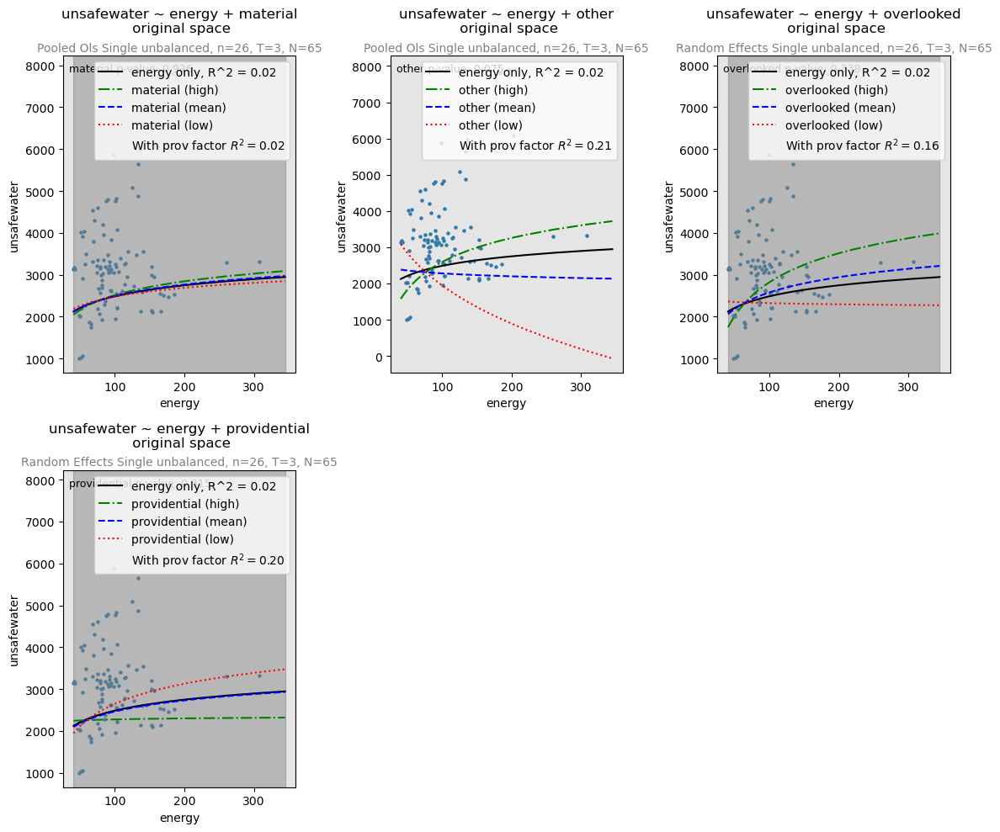

In [142]:
plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_unsafewater, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

Pooled Ols Single unbalanced
Pooled Ols Single unbalanced
Pooled Ols Single unbalanced
Pooled Ols Single unbalanced


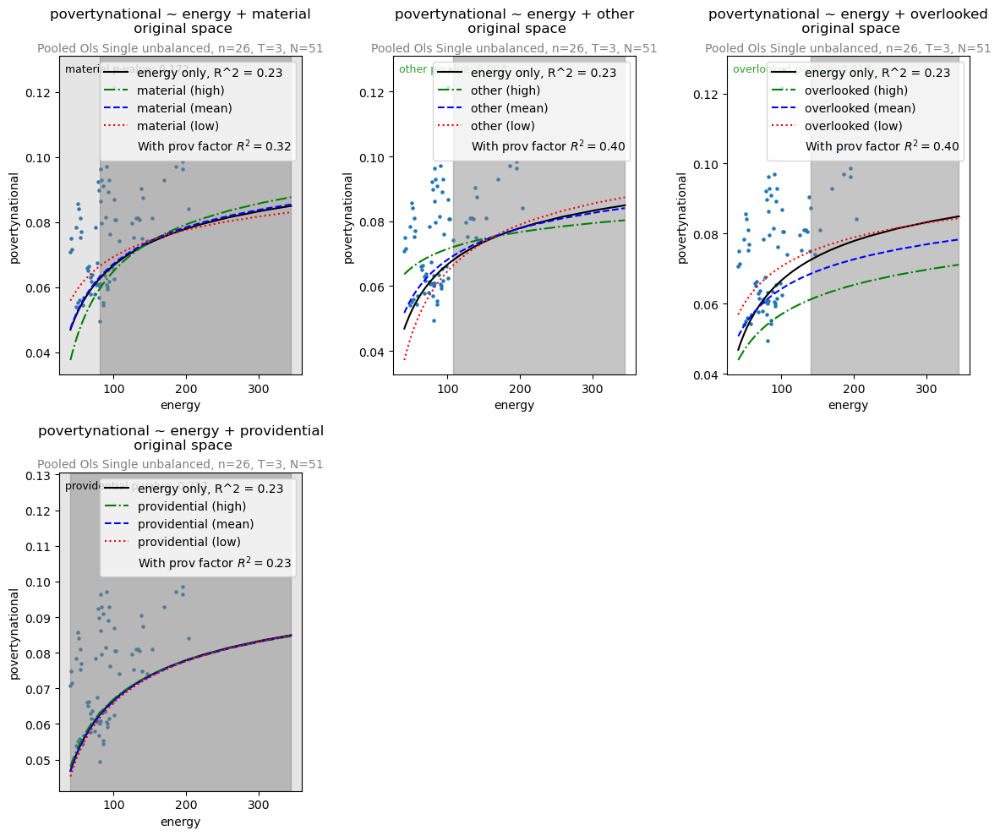

In [141]:
plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_povertynational, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

Pooled Ols Single unbalanced
Pooled Ols Single unbalanced
Pooled Ols Single unbalanced
Pooled Ols Single unbalanced


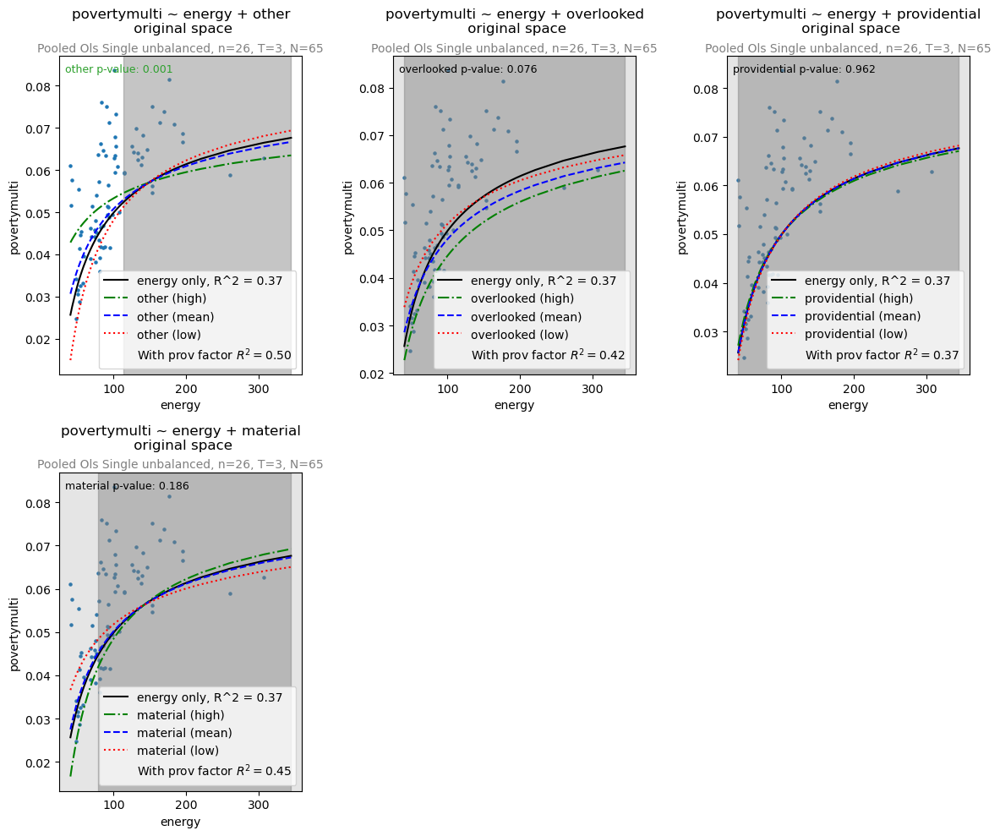

In [140]:
plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_povertymulti, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

Pooled Ols Single unbalanced
Pooled Ols Single unbalanced
Pooled Ols Single unbalanced
Pooled Ols Single unbalanced


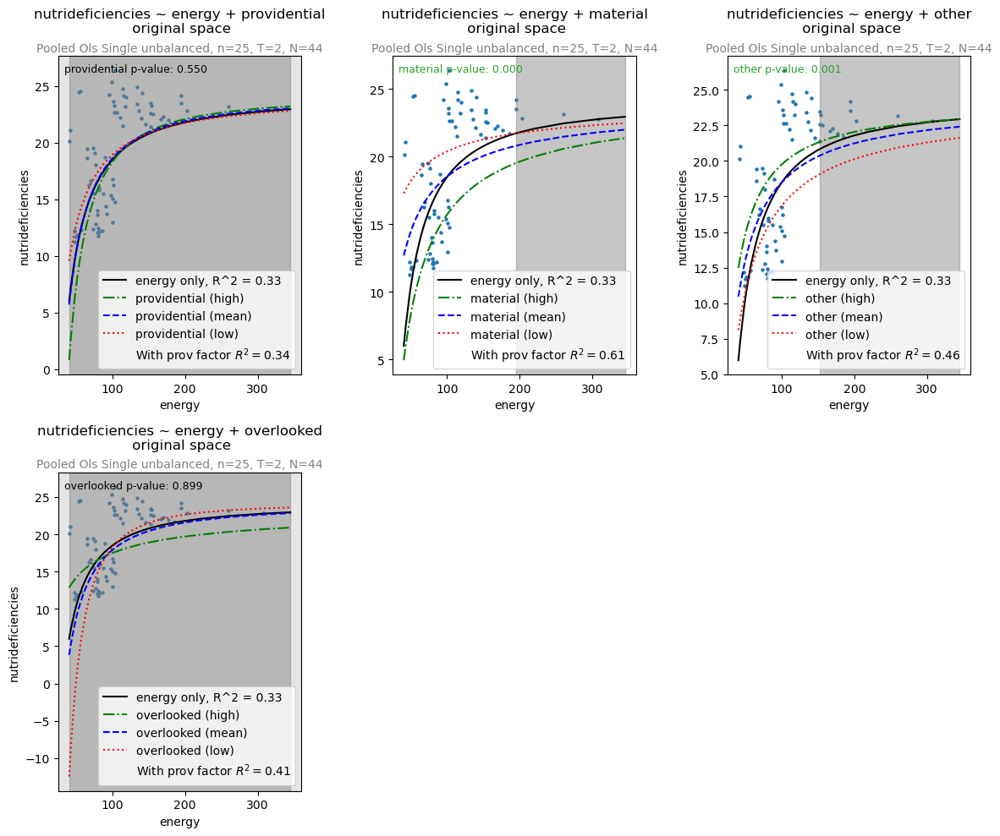

In [139]:
plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_nutrideficiencies, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

Random Effects Single unbalanced
Random Effects Single unbalanced
Random Effects Single unbalanced
Random Effects Single unbalanced


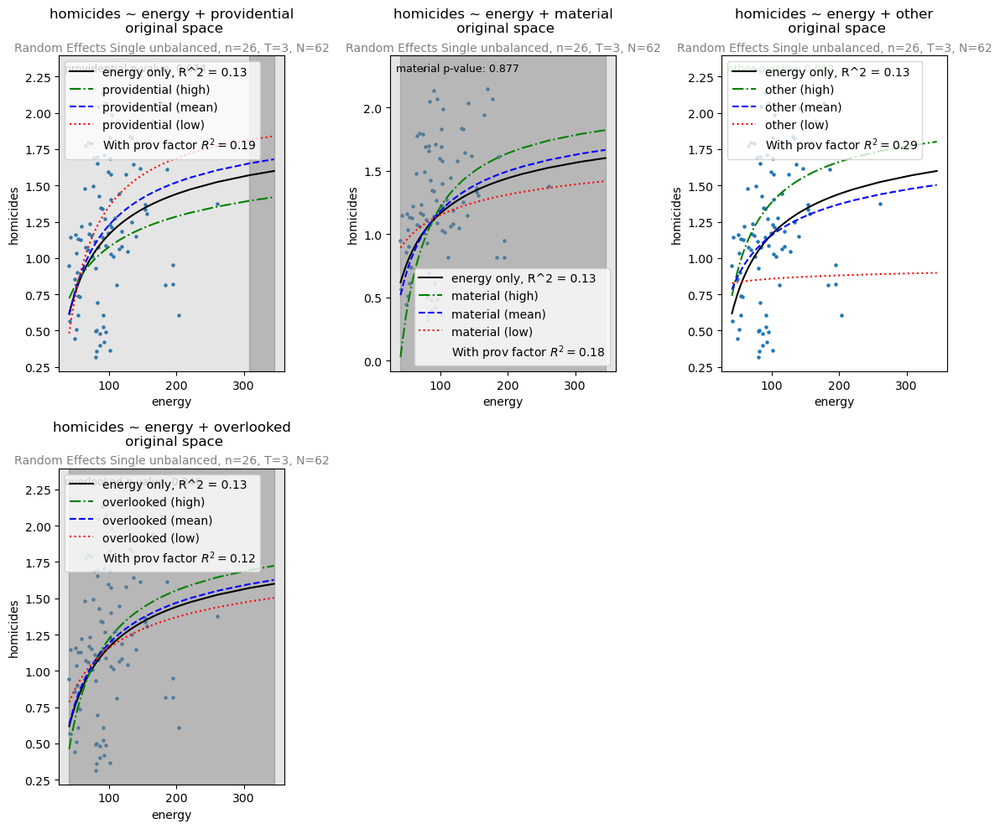

In [138]:
plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_homicides, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

Pooled Ols Single unbalanced
Random Effects Single unbalanced
Pooled Ols Single unbalanced
Random Effects Single unbalanced


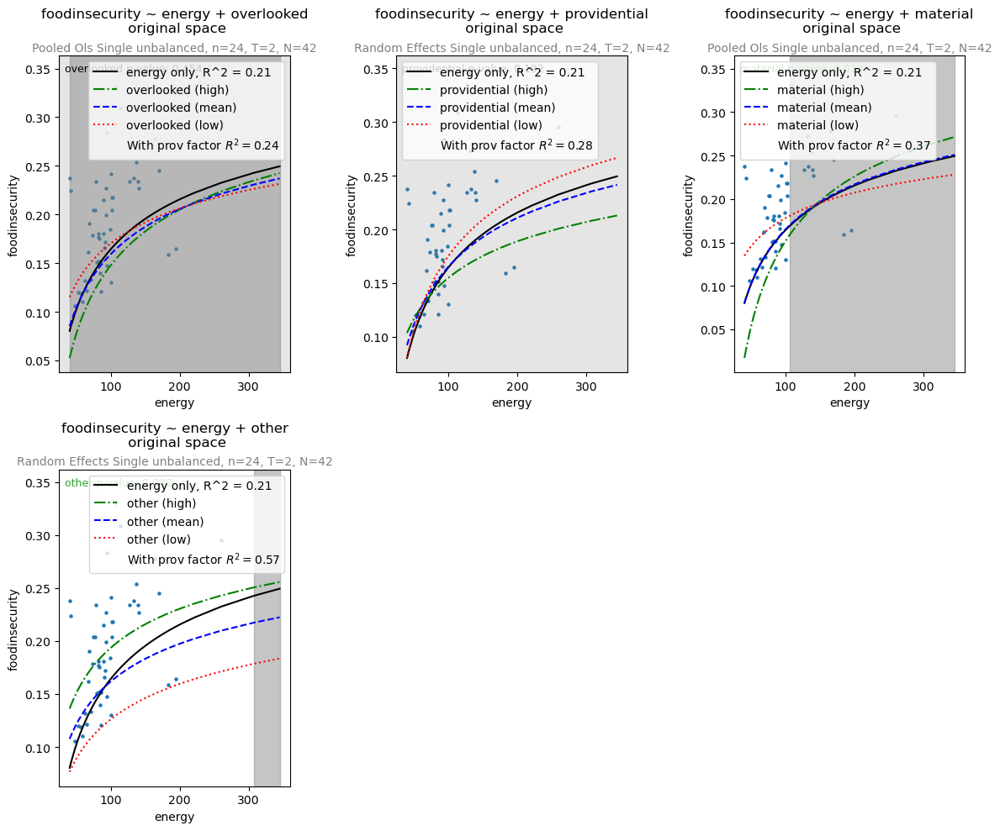

In [137]:
plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_foodinsecurity, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

Pooled Ols Single unbalanced
Pooled Ols Single unbalanced
Pooled Ols Single unbalanced
Pooled Ols Single unbalanced


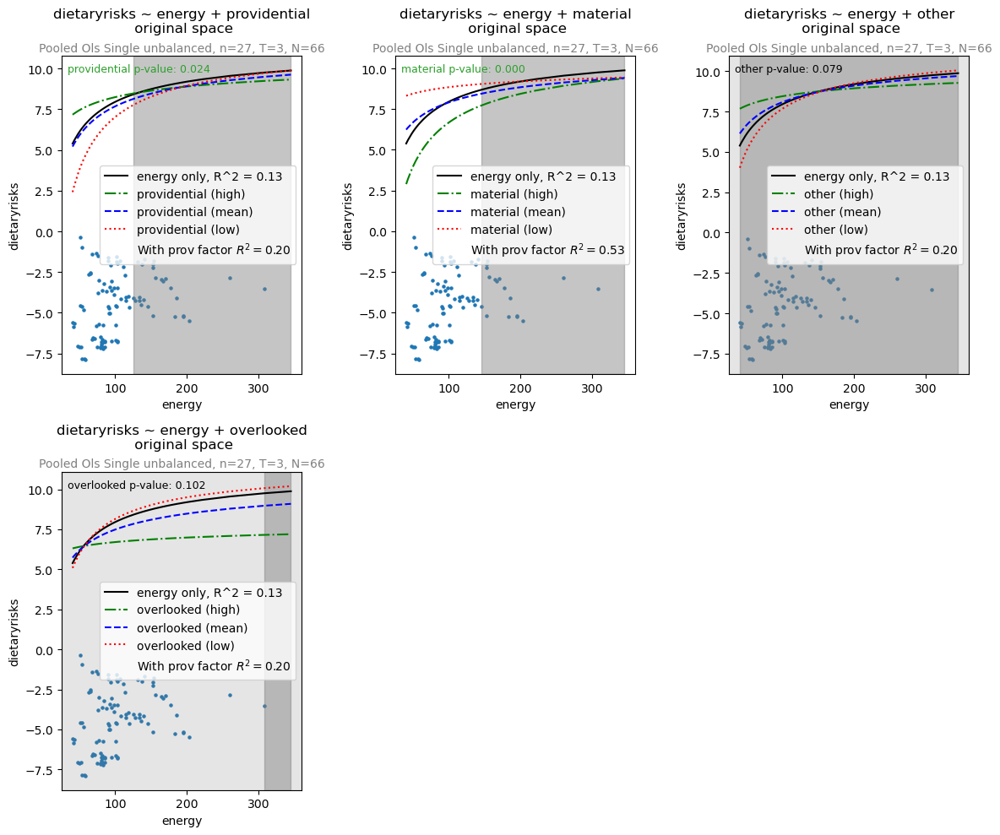

In [136]:
plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_dietaryrisks, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

Pooled Ols Single unbalanced
Pooled Ols Single unbalanced
Random Effects Single unbalanced
Random Effects Single unbalanced


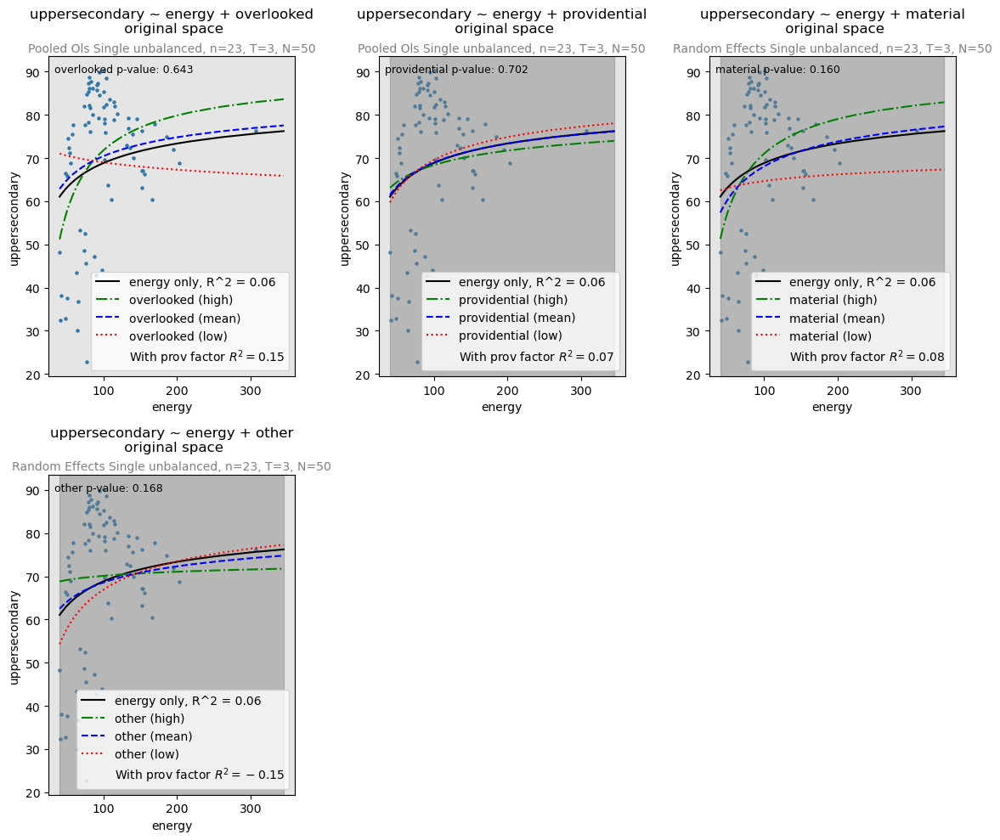

In [135]:
plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_uppersecondary, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

Pooled Ols Single unbalanced
Pooled Ols Single unbalanced
Pooled Ols Single unbalanced
Pooled Ols Single unbalanced


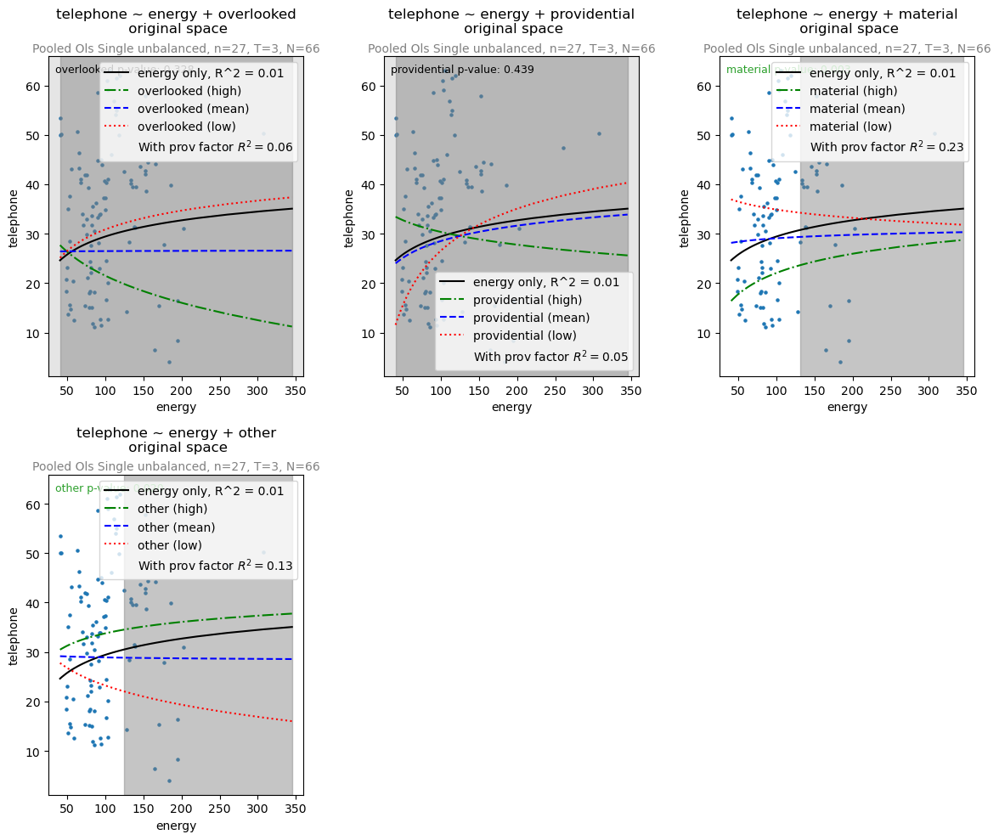

In [134]:
plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_telephone, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

Pooled Ols Single unbalanced
Pooled Ols Single unbalanced
Random Effects Single unbalanced
Pooled Ols Single unbalanced


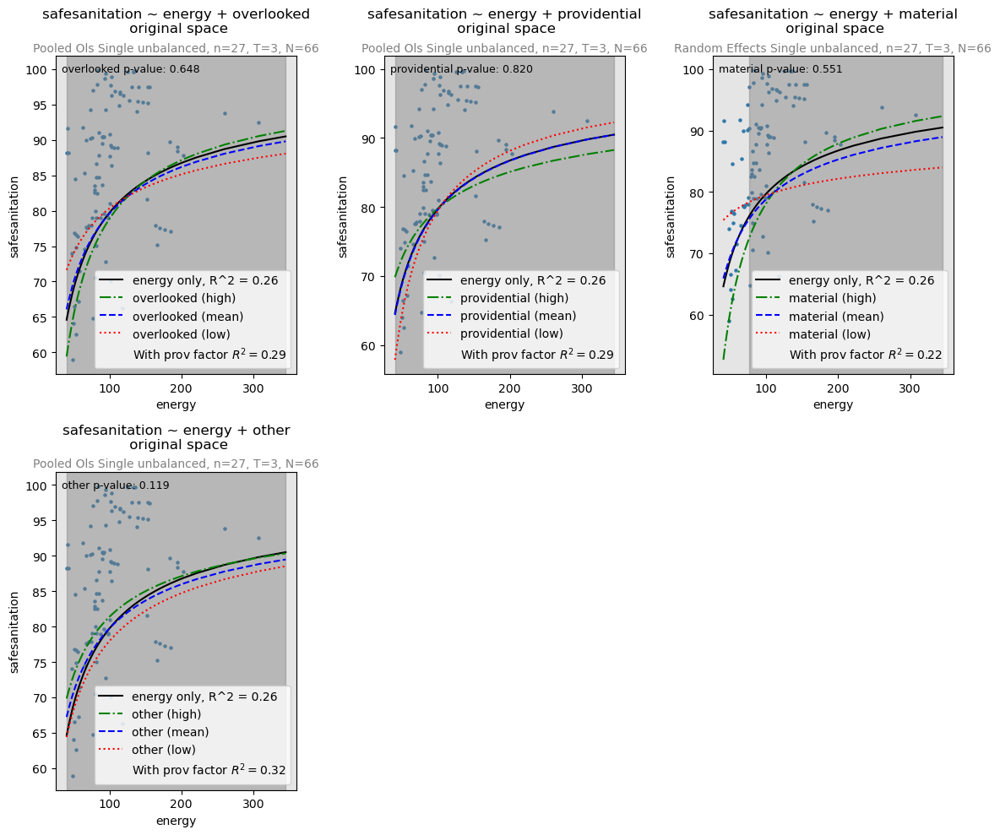

In [133]:
plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_safesanitation, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

Pooled Ols Single unbalanced
Pooled Ols Single unbalanced
Random Effects Single unbalanced
Pooled Ols Single unbalanced


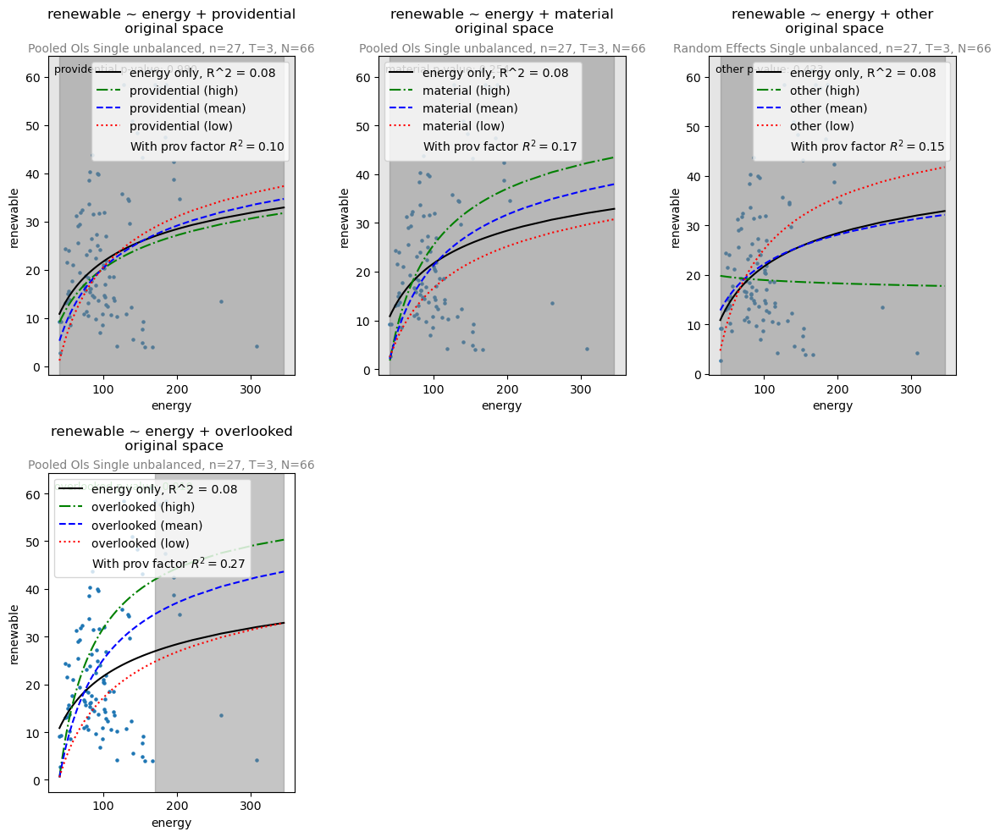

In [132]:
plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_renewable, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

Pooled Ols Single unbalanced
Pooled Ols Single unbalanced
Pooled Ols Single unbalanced
Pooled Ols Single unbalanced


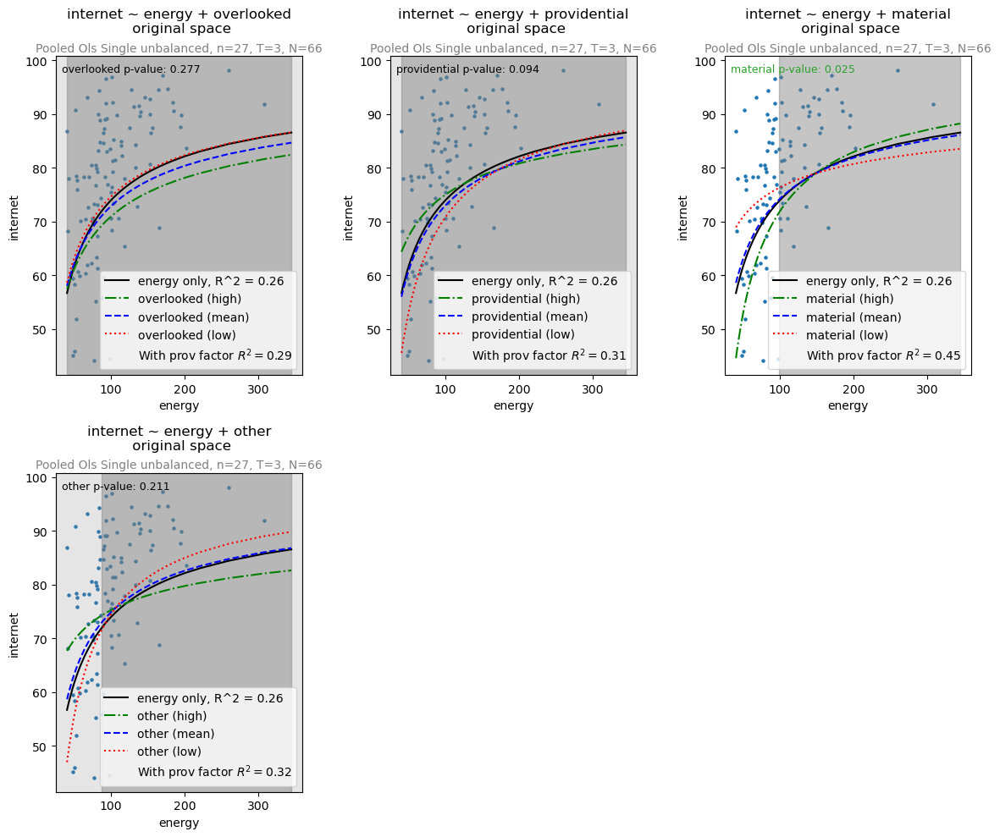

In [131]:
plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_internet, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

Pooled Ols Single unbalanced


Pooled Ols Single unbalanced
Pooled Ols Single unbalanced
Pooled Ols Single unbalanced


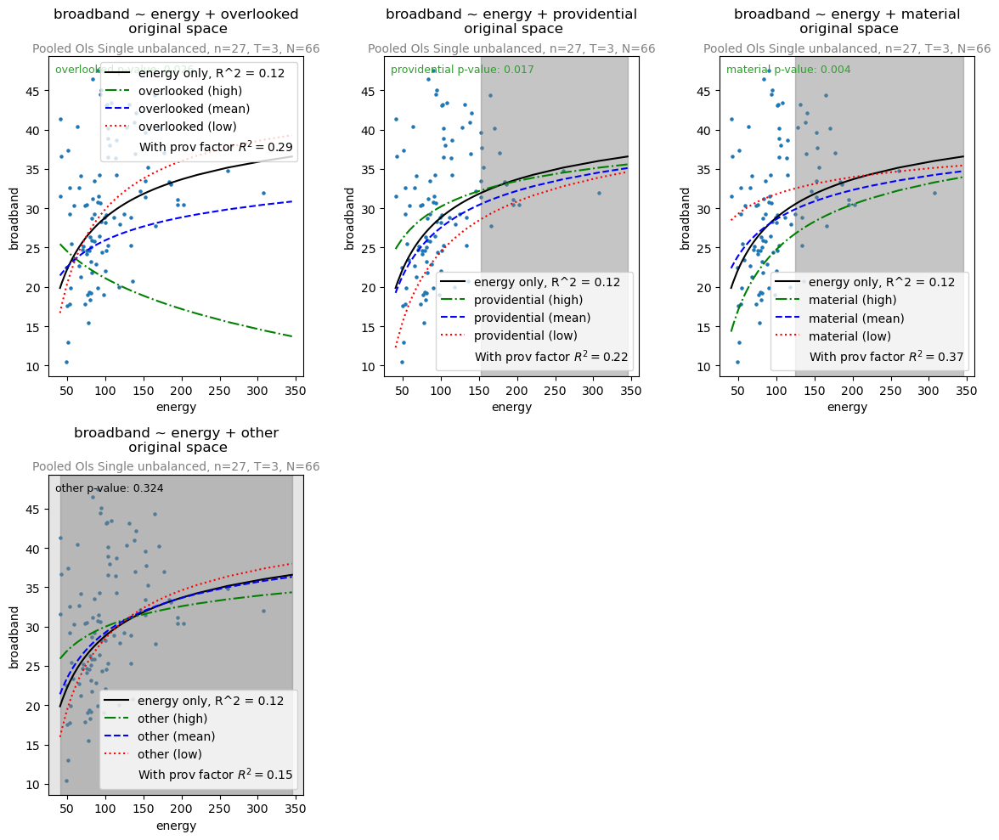

In [117]:
plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_broadband, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

In [118]:
# plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_immunization, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

In [119]:
# plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_hospitalbeds, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

In [120]:
# plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_infantmortality, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

In [121]:
# plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_roadinjury, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

In [122]:
# plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_housing, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

In [123]:
# plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_rail, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

In [124]:
# plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_communicable, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

In [125]:
# plot_regression_combinations(best_df_regressions_unbalanced, df_regressions_unique_combinations_suicide, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True, cols=3)

In [126]:
# plot_regression_combinations(best_df_regressions, df_regressions_unique_combinations, back_transformed_data, foundational_df_transformed, scaler_df, back_transform=True)

In [127]:
# plot_regression_combinations(best_df_regressions, df_regressions_unique_combinations, back_transformed_data, foundational_df_transformed, scaler_df, type='marginal_effects')

## EXIOBASE energy data, Labour Cost Survey labour shares (using this for the thesis)

In [128]:
# plot_regression_combinations(best_df_regressions_exiobase, df_regressions_exiobase_unique_combinations, back_transformed_data_exiobase, foundational_df_transformed_exiobase, scaler_df_exiobase, back_transform=True)

In [129]:
# plot_regression_combinations(best_df_regressions_exiobase, df_regressions_exiobase_unique_combinations, back_transformed_data_exiobase, foundational_df_transformed_exiobase, scaler_df_exiobase, type='marginal_effects')